# Plots in Julia

To learn more, go to: https://docs.juliaplots.org/latest/

### Installation
Julia has lots of different ways to make plots in Julia. In order to use them, we will have to install the plots package.

In [38]:
import Pkg
Pkg.add("Plots");

# to get the latest features:
Pkg.pkg"add Plots#master"

# install backend libraries. this is explained later
Pkg.add("PyPlot")
Pkg.add("GR")
Pkg.add("Plotly")
gr(size=(400,300), legend=true) # set first backend to gr

  Resolving package versions...


Updating `~/.julia/environments/v1.5/Project.toml`
  [91a5bcdd] ~ Plots v1.10.6 `https://github.com/JuliaPlots/Plots.jl.git#master` ⇒ v1.10.6
Updating `~/.julia/environments/v1.5/Manifest.toml`
  [91a5bcdd] ~ Plots v1.10.6 `https://github.com/JuliaPlots/Plots.jl.git#master` ⇒ v1.10.6
   Updating git-repo `https://github.com/JuliaPlots/Plots.jl.git`


  Resolving package versions...
Updating `~/.julia/environments/v1.5/Project.toml`
  [91a5bcdd] ~ Plots v1.10.6 ⇒ v1.10.6 `https://github.com/JuliaPlots/Plots.jl.git#master`
Updating `~/.julia/environments/v1.5/Manifest.toml`
  [91a5bcdd] ~ Plots v1.10.6 ⇒ v1.10.6 `https://github.com/JuliaPlots/Plots.jl.git#master`
  Resolving package versions...
No Changes to `~/.julia/environments/v1.5/Project.toml`
No Changes to `~/.julia/environments/v1.5/Manifest.toml`
  Resolving package versions...
No Changes to `~/.julia/environments/v1.5/Project.toml`
No Changes to `~/.julia/environments/v1.5/Manifest.toml`
  Resolving package versions...
No Changes to `~/.julia/environments/v1.5/Project.toml`
No Changes to `~/.julia/environments/v1.5/Manifest.toml`


Plots.GRBackend()

### Plotting

Here is an example of a simple 2d plot

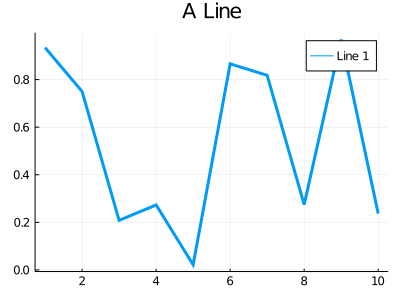

In [39]:
using Plots # import our package

x = 1:10; # get array of x values
y = rand(10); # get array of y values

# plot x vs y
plot(x, y, title = "A Line", label = "Line 1", lw = 3) # lw is for line width

We can also plot in 3D. Here is a scatter plot in 3D

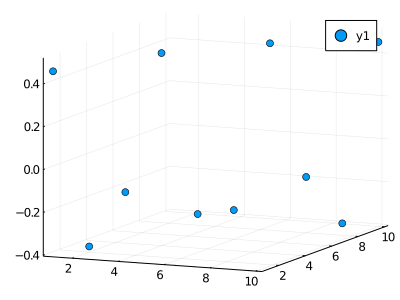

In [40]:
x = 1:10
y = 1:10
z = sin.(x).*cos.(y)

scatter(x, y, z)

Now if you notice, the legend always appears even if we don't specify it. We can actually change this.

The Plots package is actually a metapackage. Julia interprets the plot commands and then will run a backend library to  draw the graph. You can read more about this [here](https://docs.juliaplots.org/latest/tutorial/#plotting-backends).

To demonstrate, I'll change the default plot attribute values by using the GR plotting backend package and changing some default values. You can read more about the attribute values [here](https://docs.juliaplots.org/latest/generated/attributes_plot/).

In [41]:
gr(size=(500, 500), legend = false) # Set the backend to GR


Plots.GRBackend()

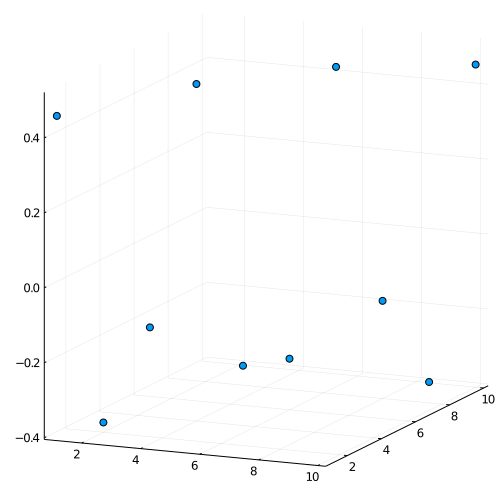

In [42]:
# plotting the scatter3 plot again
scatter(x, y, z)

### Applying to Computer Vision studies.

I will demonstrate how to superimpose a camera view onto an object view sphere given a homogeneous transform of the camera relative to the object reference frame.

#### The camera

Here is our camera. It is located at some point, and we can see a normal vector indicating the direction the camera is facing (1,1,1).

In [77]:
# change plots backend to PyPlot
plotly()

## new line
scatter([0],[0],[0])
plot!([0, 1],[0, 1],[0, 1], lw=2)

<!DOCTYPE html>
 
 
 Plots.jl

Here is our setup. We have an object somewhere in space, and a viewing sphere surrounding that object. We can also see the camera pointing in some direction.

In [81]:
# draw viewing sphere
n = 180
u = range(0.0, 2.0*π, length=n);
v = range(0.0, π,     length=n);
x = cos.(u) * sin.(v)';
y = sin.(u) * sin.(v)';
z = ones(n) * cos.(v)';
surface(x,y,z,opacity=0.5)

# draw object in center of sphere.
no = 180
uo = range(0.0, 2.0*π, length=no);
vo = range(0.0, π,     length=no);
xo = 0.1*cos.(uo) * sin.(vo)';
yo = 0.1*sin.(uo) * sin.(vo)';
zo = 0.1*ones(no) * cos.(vo)';
surface!(xo,yo,zo,opacity=1)

# draw camera in space pointing somewhere
nc = 180
uc = range(0.0, 2.0*π, length=nc);
vc = range(0.0, π,     length=nc);
xc = 0.1*cos.(uc) * sin.(vc)';
yc = 0.1*sin.(uc) * sin.(vc)';
zc = 0.1*ones(nc) * cos.(vc)';
xc = xc.+1.0;
yc = yc.+1.0;
zc = zc.+1.0;
surface!(xc,yc,zc,opacity=1)

# draw camera pointing direction
cx = [1, 1];
cy = [1, 0.6];
cz = [1, 1];
plot!(cx,cy,cx, lw=3)

<!DOCTYPE html>
 
 
 Plots.jl

Our goal is to find the normal vector on the inside of the sphere which replicates the view angle of the object seen by the camera.

Since we have the object origin at (0,0,0), we will assume that we are already working in the object reference frame.

The homogeneous transform which describes the transformation from the camera to the object is given by:

In [3]:
# load LinearAlgebra package
using LinearAlgebra

# define rotation functions
function rotz(T, thetad)
    rotationMatrix = 1.0*Matrix(I, 4,4);
    rotationMatrix[1,1] = cosd(thetad);
    rotationMatrix[1,2] = -sind(thetad);
    rotationMatrix[2,1] = sind(thetad);
    rotationMatrix[2,2] = cosd(thetad);
    rotationMatrix*T
end

function roty(T, thetad)
    rotationMatrix = 1.0*Matrix(I, 4,4);
    rotationMatrix[1,1] = cosd(thetad);
    rotationMatrix[1,3] = sind(thetad);
    rotationMatrix[3,1] = -sind(thetad);
    rotationMatrix[3,3] = cosd(thetad);
    rotationMatrix*T
end

function rotx(T, thetad)
    rotationMatrix = 1.0*Matrix(I, 4,4);
    rotationMatrix[2,2] = cosd(thetad);
    rotationMatrix[2,3] = -sind(thetad);
    rotationMatrix[3,2] = sind(thetad);
    rotationMatrix[3,3] = cosd(thetad);
    rotationMatrix*T
end

# testing
# rotx(TcamToObj, 90) # works
# roty(TcamToObj, 90) # works
# rotz(TcamToObj, 90) # works

# build starting T
TcamToObj = 1.0*Matrix(I, 4, 4);
camTranslation = [1, 1, 1]';
TcamToObj[1:3,4] = camTranslation;

TcamToObj


4×4 Array{Float64,2}:
 0.0  -1.0  0.0  -1.0
 1.0   0.0  0.0   1.0
 0.0   0.0  1.0   1.0
 0.0   0.0  0.0   1.0

Now we have the tools to describe transformations in 3d space. 

> A note: we have to pick an arbitrary direction for the camera front to be located. In this example, I choose the -X axis as the front of the camera.